In [210]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

## Australia Airbnb data set


In [211]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [212]:
# Neighbourhood list for geo filter. Sourced from city or open source GIS files.
hoods = pd.read_csv("http://data.insideairbnb.com/australia/wa/western-australia/2020-06-10/visualisations/neighbourhoods.csv")

In [301]:
hoods.to_csv('/Users/aaronkg1/Downloads/airbnb_capstone/aus_hood.csv', index = False)

In [213]:
# hoods.columns
sns.set_style("dark")

## Cleaning the Neighbourhood df   (1)
 1. drop neighbourhood_group col. 

In [214]:
hoods.tail(11)

,neighbourhood_group,neighbourhood
126,NaN,WESTONIA
127,NaN,WICKEPIN
128,NaN,WILLIAMS
129,NaN,WILUNA
130,NaN,WONGAN-BALLIDU
131,NaN,WOODANILLING
132,NaN,WYALKATCHEM
133,NaN,WYNDHAM-EAST KIMBERLEY
134,NaN,YALGOO
135,NaN,YILGARN


In [215]:
hoods.shape

(137, 2)

*The neighbourhood_group columns was removed in cell below

In [216]:
#hoods = hoods.drop(['neighbourhood_group'], axis=1)
hoods.head(7)

,neighbourhood_group,neighbourhood
0,NaN,ALBANY
1,NaN,ARMADALE
2,NaN,ASHBURTON
3,NaN,AUGUSTA-MARGARET RIVER
4,NaN,BASSENDEAN
5,NaN,BAYSWATER
6,NaN,BELMONT


In [217]:
hoods = hoods.drop(['neighbourhood_group'], axis=1)
hoods.head(7)

,neighbourhood
0,ALBANY
1,ARMADALE
2,ASHBURTON
3,AUGUSTA-MARGARET RIVER
4,BASSENDEAN
5,BAYSWATER
6,BELMONT


/Users/aaronkg1/miniconda3/lib/python3.7/site-packages/seaborn/distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


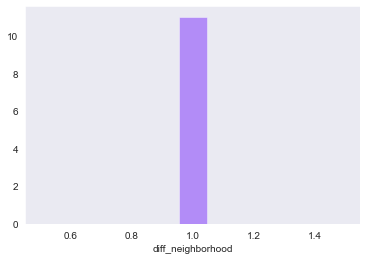

In [218]:
h = hoods.neighbourhood.value_counts()
sns.distplot(h, color = '#5E00FF', axlabel='diff_neighborhood')
sns.set_style("dark")



In [219]:
# Summary Review data and Listing ID (to facilitate time based 
# analytics and visualisations linked to a listing).
reviews = pd.read_csv("http://data.insideairbnb.com/australia/wa/western-australia/2020-06-10/visualisations/reviews.csv")

In [300]:
reviews.to_csv('/Users/aaronkg1/Downloads/airbnb_capstone/review_lis.csv', index = False)

In [220]:
#reviews = reviews.set_index("listing_id")
reviews.head(7)

,listing_id,date
0,2115,2012-10-30
1,2115,2017-09-03
2,2115,2017-10-01
3,2115,2018-04-21
4,2115,2018-09-18
5,2115,2018-10-01
6,2115,2018-10-21


In [221]:
liscount = reviews.listing_id.value_counts()
liscount

1201497     810
5919520     571
14111398    524
594849      511
11929449    445
10098424    434
4780755     427
18618355    418
10813836    418
16006658    410
6769149     408
3120346     401
4220015     394
11896294    386
764096      385
891022      384
13590565    378
14341055    377
6749954     362
5919840     354
9321554     351
18619999    349
8849486     348
16619638    347
348872      340
7133510     340
14407258    340
16805468    337
19211951    335
11910841    332
19232677    327
23790043    326
13759764    325
11424266    323
16138191    319
4351429     318
9421738     317
1633888     315
23386417    314
17812809    311
13480079    309
678944      307
6415712     306
15910048    304
15305399    304
4247709     304
3898900     303
12326677    303
4448878     297
12294156    295
588298      293
14585300    292
15625679    290
6904611     289
4442914     285
5061392     285
13195475    284
4016356     284
23423709    280
5338839     278
8652441     276
8663120     276
6150960 

## Clean reviews df
1.  change date column to a datetime data type


In [ ]:
reviews.info()

In [ ]:
# reviews = reviews.reset_index('listing_id')
reviews.head(4)

In [ ]:
x = reviews.listing_id.unique()
sns.distplot(x, color = '#5E00FF', axlabel='string')
sns.set_style("dark")



In [ ]:
#Changing to datetime data type
reviews['date'] = pd.to_datetime(reviews['date'])


In [ ]:
reviews.info()

In [ ]:
reviews.tail(7)

In [ ]:
ax = sns.lineplot(x = 'date', y = 'listing_id', data = reviews, hue_order=)
ax

In [ ]:
reviews.date.min()

In [ ]:
reviews.date.mean()

In [ ]:
reviews.date.max()

In [ ]:
fig = plt.figure(figsize=(12,12))
for i in range(5):
    ax = fig.add_subplot(5,1,i+1)
    start_index = i*12
    end_index = (i+1)*12
    subset = reviews[start_index:end_index]
    ax.plot(subset['date'], subset['VALUE'])

In [ ]:
# Summary information and metrics for 
# listings in Western Australia (good for visualisations).
lis = pd.read_csv("http://data.insideairbnb.com/australia/wa/western-australia/2020-06-10/visualisations/listings.csv")

In [299]:
lis.to_csv('/Users/aaronkg1/Downloads/airbnb_capstone/metric_listing.csv', index = False)

In [ ]:
lis.head(7)

In [ ]:
mike = lis[lis['host_name'] == 'Michael']
mikey = mike['host_id'] == 3161391
mikey.value_counts()

In [ ]:
lis.shape

In [ ]:
host_hood = lis.groupby(['host_id','neighbourhood'])
host_hood.price.mean().sort_values('neighbourhood', ascending=False)

## Clean Listing df

1. set index to id col
2. change last_review col into datetime obj
3. drop neighbourhood_group col


In [ ]:
fig = plt.figure(figsize=(20, 20))
fig, ax = plt.subplots()
ax.scatter(lis['neighbourhood'], lis['room_type'])
ax.set_xlabel("Towns")
ax.set_ylabel("room types")
# plt.plot(lis[12:24]["MONTH"], lis[12:24]["VALUE"], c="blue")
# plt.plot(lis[24:36]["MONTH"], lis[24:36]["VALUE"], c="green")
# plt.plot(lis[36:48]["MONTH"], lis[36:48]["VALUE"], c="orange")
# # plt.plot(unrate[48:60]["MONTH"], unrate[48:60]["VALUE"], c="black")



In [ ]:
lis = lis.drop(['neighbourhood_group'], axis=1)
lis.head(5)

In [ ]:
lis.

In [ ]:
roomtype = lis['room_type'].value_counts()
roomtype

In [ ]:
roomtypes = lis['room_type'].count()
roomtypes

In [ ]:
# Need a count of listings/neighborhood
group = lis.groupby(['neighbourhood','id'])
group.id.count()

In [ ]:
maj = lis.price.mean()
maj

In [ ]:
pop_lis = lis.groupby(['id'])
pop = pop_lis.mean()
# sns.distplot(pop, color = '#5E00FF', axlabel='id',)
# sns.set_style("dark")
# sns.lineplot(x= 'id', y = 'price', data = lis)

In [ ]:
pop

In [ ]:
group = lis['neighbourhood']
group.value_counts()

# sns.set_style("dark")

In [ ]:
sns.distplot(h, color = '#5E00FF', axlabel='diff_neighborhood')
sns.set_style("dark")



## Startting to break down of the top 4 towns in W.Australia (Busselton, Stirling, Perth, Augusta-Margrat-River)
1) Find the top listing count of each of the 4 towns.

2) Find correlation amouugst the top listing of each of the 4 towns

In [ ]:
bussels = lis.loc[lis['neighbourhood'] == 'BUSSELTON']
bussels.head(4)
# bussels.price.median()

In [ ]:
bussels.price.value_counts()

In [ ]:
top_bus = lis[lis['host_id'] == 15360130]
top_bus.head(4)

In [ ]:
top_bus.number_of_reviews.mean()

In [ ]:
amr = lis.loc[lis['neighbourhood'] == 'AUGUSTA-MARGARET RIVER']
amr.head(4)

In [ ]:
amr.price.mean()

In [ ]:
amr.price.max()

In [ ]:
amr.host_id.value_counts()

In [ ]:
# top AMR host_id 27074418
top_amr = lis[lis['host_id'] == 5373199]
top_amr

In [ ]:
top_amr.name

##### Specs on Busselton
1. Avg Price $299.
2. Max price $5000
3. Median price $250
4. Min price $43

In [ ]:
bussels.host_id.value_counts()

In [ ]:
bgroup = bussels.groupby(['id','name', 'host_id'])
bgroup.id.value_counts()

In [ ]:
stirling = lis.loc[lis['neighbourhood'] == 'STIRLING']
stirling.

In [ ]:
# Number of listings by Neighborhood
lis.neighbourhood.value_counts()

In [ ]:
stir = lis.loc[lis['neighbourhood'] == 'STIRLING']
stir.head(4)

In [ ]:
# Finding the top listing for the town Striling
stir.host_id.value_counts()

In [ ]:
stir.price.mean()

In [ ]:
stir.price.value_counts()

In [223]:
# top host in Stirling. Host_id 215985827
# with an avg reviews of 10
top_sti = lis[lis['host_id'] == 215985827]
top_sti.head(4)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
7708,28618817,"Ocean View-Breath taking Views, Amazing Facili...",215985827,Caroline & Gabi,STIRLING,-31.89120,115.75687,Entire home/apt,340,5,20,2020-02-16,1.04,29,328
7726,28648857,Eagles Nest Holiday or Business Apartment.,215985827,Caroline & Gabi,STIRLING,-31.89936,115.76283,Entire home/apt,111,2,9,2020-04-07,0.43,29,358
7767,28792372,Acacia Holiday or Business Stay - Quiet Location,215985827,Caroline & Gabi,STIRLING,-31.89936,115.76283,Entire home/apt,120,2,4,2020-03-20,0.20,29,360
7769,28793897,West Beach Lagoon 218 - Outstanding Value!,215985827,Caroline & Gabi,STIRLING,-31.89715,115.75782,Entire home/apt,92,2,10,2020-03-11,0.49,29,361


In [224]:
top_sti.number_of_reviews.mean()

10.241379310344827

In [225]:
perth = lis.loc[lis['neighbourhood'] == 'PERTH']
perth.head(4)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
88,739993,One Bedroom Apartment @ The Waldorf,3872122,Belinda,PERTH,-31.95559,115.84813,Entire home/apt,98,1,220,2020-03-25,2.38,1,345
98,768678,Inner City / Kings Park / West End,4054831,Graeme,PERTH,-31.95353,115.84769,Private room,70,7,3,2016-09-13,0.03,1,365
99,780236,Stylish Apartment in West Perth,4114428,Jodie,PERTH,-31.94558,115.84366,Private room,121,1,1,2015-10-25,0.02,1,365
113,827350,Newly renovated quiet oasis in the city centre,3512722,Jemma,PERTH,-31.95161,115.85654,Entire home/apt,129,1,263,2020-06-08,2.88,2,347


In [226]:
# Top listing in the town of Perth
top_perth = lis[lis['host_id'] == 170107339]
top_perth

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
6133,23033297,myOZexp Palmerston Lodge - Bed in 4 bed dorm,170107339,Marco,PERTH,-31.94461,115.85642,Shared room,17,7,2,2020-03-29,0.08,34,90
6203,23210302,myOZexp Palmerston Lodge - Bed in 4 bed dorm,170107339,Marco,PERTH,-31.94540,115.85513,Shared room,17,3,3,2018-06-21,0.11,34,90
6204,23210537,myOZexp Palmerston Lodge - Bed in 4 bed dorm,170107339,Marco,VINCENT,-31.94388,115.85740,Shared room,17,7,2,2018-04-19,0.07,34,89
6205,23210679,myOZexp Palmerston Lodge - Bed in 4 bed dorm,170107339,Marco,VINCENT,-31.94332,115.85715,Shared room,17,3,10,2020-03-21,0.36,34,90
6247,23326951,myOZexp Palmerston Lodge - Bed in 4 bed dorm,170107339,Marco,VINCENT,-31.94358,115.85734,Shared room,17,3,0,NaN,NaN,34,90
6257,23345318,myOZexp Palmerston Lodge - Bed in 6 bed dorm,170107339,Marco,VINCENT,-31.94349,115.85525,Shared room,17,3,1,2018-08-17,0.05,34,90
6258,23345370,myOZexp Palmerston Lodge - Bed in 6 bed dorm,170107339,Marco,VINCENT,-31.94404,115.85703,Shared room,17,3,2,2018-07-02,0.08,34,90
6259,23345407,myOZexp Palmerston Lodge - Bed in 6 bed dorm,170107339,Marco,VINCENT,-31.94334,115.85556,Shared room,17,3,0,NaN,NaN,34,90
6289,23420981,myOZexp Palmerston Lodge - Bed in 4 bed dorm,170107339,Marco,PERTH,-31.94552,115.85697,Shared room,17,3,0,NaN,NaN,34,90
6290,23421055,myOZexp Palmerston Lodge - Bed in 4 bed dorm,170107339,Marco,PERTH,-31.94381,115.85537,Shared room,17,3,3,2020-01-11,0.12,34,90


In [227]:
perth.price.mean()

140.0164609053498

In [228]:
perth.host_id.value_counts()

170107339    25
168687698    23
157230313    16
116169765    15
106486177    12
21681807     12
91208602     11
99307518     11
182097013    11
34477031     10
138068839     9
224230796     9
17579312      8
267106440     8
171873627     8
98558421      8
48939744      8
149018124     7
31384839      7
12629396      7
314949968     7
54557509      6
88258624      6
6202448       6
234905295     6
1621466       5
286353306     5
139814833     5
43970035      5
1778078       5
10629754      5
266163027     4
92346908      4
111653446     4
158783903     3
10904158      3
241590849     3
278324601     3
66526740      3
320548969     3
35603747      3
6538079       3
230486966     3
55351831      3
34618640      3
25285706      3
18119599      3
46500278      3
104616928     3
151362668     3
4204269       2
22525541      2
40069838      2
106569640     2
8598574       2
86822512      2
50412343      2
27502637      2
213323437     2
13394280      2
84037363      2
82569703      2
44221662

In [229]:
# Types of rooms 
lis['room_type'].value_counts()

Entire home/apt    9076
Private room       3123
Hotel room          128
Shared room         127
Name: room_type, dtype: int64

In [230]:
lis.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood', 'latitude',
       'longitude', 'room_type', 'price', 'minimum_nights',
       'number_of_reviews', 'last_review', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365'],
      dtype='object')

In [231]:
# The neighbourhood_group col was drop in this here
# lis = lis.drop(['neighbourhood_group'], axis=1)
lis.head(5)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2115,Como Quality Suite Accommodation,2313,Helen,SOUTH PERTH,-32.00871,115.86407,Private room,101,2,19,2020-06-04,0.20,1,143
1,37688,Living in our family home,162227,Theja,MELVILLE,-32.06806,115.87674,Private room,72,1,0,NaN,NaN,1,365
2,42713,Bed with Breakfast,186576,Denise,IRWIN,-29.25216,114.93205,Private room,94,1,7,2019-10-03,0.11,1,365
3,45825,St James for short-longer stay?,204056,Carol,CANNING,-32.00395,115.91394,Private room,60,3,0,NaN,NaN,2,365
4,58329,Trewent Farmhouse - rustic & rambling,277321,Karen,MANJIMUP,-34.35542,116.18267,Entire home/apt,220,2,43,2020-06-01,0.42,2,1


In [232]:
lis.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12454 entries, 0 to 12453
Data columns (total 15 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              12454 non-null  int64  
 1   name                            12452 non-null  object 
 2   host_id                         12454 non-null  int64  
 3   host_name                       12449 non-null  object 
 4   neighbourhood                   12454 non-null  object 
 5   latitude                        12454 non-null  float64
 6   longitude                       12454 non-null  float64
 7   room_type                       12454 non-null  object 
 8   price                           12454 non-null  int64  
 9   minimum_nights                  12454 non-null  int64  
 10  number_of_reviews               12454 non-null  int64  
 11  last_review                     10669 non-null  object 
 12  reviews_per_month               

In [233]:
# Changing the last_review column into a datetime object
lis['last_review'] = pd.to_datetime(lis['last_review'])
lis.head(7)

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2115,Como Quality Suite Accommodation,2313,Helen,SOUTH PERTH,-32.00871,115.86407,Private room,101,2,19,2020-06-04,0.20,1,143
1,37688,Living in our family home,162227,Theja,MELVILLE,-32.06806,115.87674,Private room,72,1,0,NaT,NaN,1,365
2,42713,Bed with Breakfast,186576,Denise,IRWIN,-29.25216,114.93205,Private room,94,1,7,2019-10-03,0.11,1,365
3,45825,St James for short-longer stay?,204056,Carol,CANNING,-32.00395,115.91394,Private room,60,3,0,NaT,NaN,2,365
4,58329,Trewent Farmhouse - rustic & rambling,277321,Karen,MANJIMUP,-34.35542,116.18267,Entire home/apt,220,2,43,2020-06-01,0.42,2,1
5,59311,family home in canning vale,284743,Rudy And Lina,GOSNELLS,-32.07592,115.93188,Private room,64,1,7,2018-04-28,0.06,1,362
6,65261,"Bright but cosy Fremantle Unit, 1-2 Guests",319052,Suzanne Elizabeth,FREMANTLE,-32.04964,115.76582,Entire home/apt,62,2,233,2020-04-04,2.14,1,89


### neighbourhood_group Column was dropped

In [234]:
host = lis.groupby(['host_id','host_name','calculated_host_listings_count',])

In [235]:
host.count()

,,,id,name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,availability_365
host_id,host_name,calculated_host_listings_count,,,,,,,,,,,,
2313,Helen,1,1,1,1,1,1,1,1,1,1,1,1,1
99080,Fiona,1,1,1,1,1,1,1,1,1,1,1,1,1
99849,Susan And Mark,2,2,2,2,2,2,2,2,2,2,2,2,2
121587,Andrea,1,1,1,1,1,1,1,1,1,1,1,1,1
123731,John,2,2,2,2,2,2,2,2,2,2,2,2,2
128712,Lewis,1,1,1,1,1,1,1,1,1,1,1,1,1
133655,Louise,1,1,1,1,1,1,1,1,1,1,0,0,1
140323,Dixie,1,1,1,1,1,1,1,1,1,1,1,1,1
162227,Theja,1,1,1,1,1,1,1,1,1,1,0,0,1


In [236]:
lis.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12454 entries, 0 to 12453
Data columns (total 15 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              12454 non-null  int64         
 1   name                            12452 non-null  object        
 2   host_id                         12454 non-null  int64         
 3   host_name                       12449 non-null  object        
 4   neighbourhood                   12454 non-null  object        
 5   latitude                        12454 non-null  float64       
 6   longitude                       12454 non-null  float64       
 7   room_type                       12454 non-null  object        
 8   price                           12454 non-null  int64         
 9   minimum_nights                  12454 non-null  int64         
 10  number_of_reviews               12454 non-null  int64         
 11  la

In [237]:
# Detailed Review Data for listings in Western Australia
reviews_ = pd.read_csv("http://data.insideairbnb.com/australia/wa/western-australia/2020-06-10/data/reviews.csv.gz")

In [298]:
reviews_.to_csv('/Users/aaronkg1/Downloads/airbnb_capstone/reviews.csv', index = False)

In [238]:
reviews_.head(4)

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2115,2757959,2012-10-30,2091550,Albert,"Schönes App. mit grossen, sauberen Zimmern. He..."
1,2115,189850506,2017-09-03,19212496,Mandy,My two daughters and I were grateful for the c...
2,2115,198932959,2017-10-01,4244731,Suliman,"A perfect place and host, thank you for the wo..."
3,2115,255553398,2018-04-21,172272225,Sharon,Great location and very comfortable. Helen is ...


In [239]:
reviews_.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378566 entries, 0 to 378565
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   listing_id     378566 non-null  int64 
 1   id             378566 non-null  int64 
 2   date           378566 non-null  object
 3   reviewer_id    378566 non-null  int64 
 4   reviewer_name  378566 non-null  object
 5   comments       378374 non-null  object
dtypes: int64(3), object(3)
memory usage: 17.3+ MB


## Clean reviews_ df
1. Use listing_id for set index
2. Change date col into a datetime data type

In [241]:
reviews_['date'] = pd.to_datetime(reviews_['date'])

In [242]:
reviews_.head(2)

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2115,2757959,2012-10-30,2091550,Albert,"Schönes App. mit grossen, sauberen Zimmern. He..."
1,2115,189850506,2017-09-03,19212496,Mandy,My two daughters and I were grateful for the c...


In [243]:
reviews_.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378566 entries, 0 to 378565
Data columns (total 6 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   listing_id     378566 non-null  int64         
 1   id             378566 non-null  int64         
 2   date           378566 non-null  datetime64[ns]
 3   reviewer_id    378566 non-null  int64         
 4   reviewer_name  378566 non-null  object        
 5   comments       378374 non-null  object        
dtypes: datetime64[ns](1), int64(3), object(2)
memory usage: 17.3+ MB


In [244]:
reviews_.date.max()

Timestamp('2020-06-11 00:00:00')

In [245]:
reviews_.listing_id.value_counts()

1201497     810
5919520     571
14111398    524
594849      511
11929449    445
10098424    434
4780755     427
18618355    418
10813836    418
16006658    410
6769149     408
3120346     401
4220015     394
11896294    386
764096      385
891022      384
13590565    378
14341055    377
6749954     362
5919840     354
9321554     351
18619999    349
8849486     348
16619638    347
348872      340
7133510     340
14407258    340
16805468    337
19211951    335
11910841    332
19232677    327
23790043    326
13759764    325
11424266    323
16138191    319
4351429     318
9421738     317
1633888     315
23386417    314
17812809    311
13480079    309
678944      307
6415712     306
15910048    304
15305399    304
4247709     304
3898900     303
12326677    303
4448878     297
12294156    295
588298      293
14585300    292
15625679    290
6904611     289
4442914     285
5061392     285
13195475    284
4016356     284
23423709    280
5338839     278
8652441     276
8663120     276
6150960 

In [302]:
# Detailed Calendar Data for listings in Western Australia
cal = pd.read_csv("http://data.insideairbnb.com/australia/wa/western-australia/2020-06-10/data/calendar.csv.gz")

In [303]:
cal.to_csv('/Users/aaronkg1/Downloads/airbnb_capstone/calender.csv', index = False)

In [247]:
cal.columns

Index(['listing_id', 'date', 'available', 'price', 'adjusted_price',
       'minimum_nights', 'maximum_nights'],
      dtype='object')

In [248]:
cal.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4545356 entries, 0 to 4545355
Data columns (total 7 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   listing_id      int64 
 1   date            object
 2   available       object
 3   price           object
 4   adjusted_price  object
 5   minimum_nights  int64 
 6   maximum_nights  int64 
dtypes: int64(3), object(4)
memory usage: 242.7+ MB


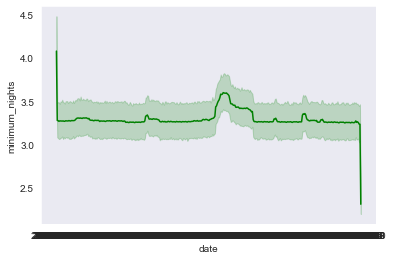

In [249]:
ax = sns.lineplot(x = 'date', y = 'minimum_nights', data = cal, hue_order='listing_id', color='green')

## Clean Calender df

1. Change date col into datetime obj
2. Change price col into int type
3. Change adjusted_price col into an int type
4. Change available col into Y or N

In [250]:
cal['date'] = pd.to_datetime(cal['date'])
cal.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4545356 entries, 0 to 4545355
Data columns (total 7 columns):
 #   Column          Dtype         
---  ------          -----         
 0   listing_id      int64         
 1   date            datetime64[ns]
 2   available       object        
 3   price           object        
 4   adjusted_price  object        
 5   minimum_nights  int64         
 6   maximum_nights  int64         
dtypes: datetime64[ns](1), int64(3), object(3)
memory usage: 242.7+ MB


In [251]:
cal.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4545356 entries, 0 to 4545355
Data columns (total 7 columns):
 #   Column          Dtype         
---  ------          -----         
 0   listing_id      int64         
 1   date            datetime64[ns]
 2   available       object        
 3   price           object        
 4   adjusted_price  object        
 5   minimum_nights  int64         
 6   maximum_nights  int64         
dtypes: datetime64[ns](1), int64(3), object(3)
memory usage: 242.7+ MB


In [252]:
cal.head(4)

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,2115,2020-06-10,t,$95.00,$95.00,2,1125
1,284891,2020-06-10,f,$44.00,$44.00,1,31
2,284891,2020-06-11,f,$44.00,$44.00,1,31
3,284891,2020-06-12,f,$44.00,$44.00,1,31


In [292]:
calav = cal[cal['available'] == 'f']
calav.listing_id.value_counts()

30221797    365
20774705    365
19645349    365
2316603     365
14259265    365
           ... 
42843648      1
152402        1
23454632      1
42318341      1
9413728       1
Name: listing_id, Length: 11817, dtype: int64

* They're are 2017950 listings that are unavailable .
* this is interpret as listings that are 'f' i availability, means that they are hosting and making money

In [254]:
avail = cal.groupby(['listing_id', 'available', 'price'])
avail.price.sum().sort_values()

listing_id  available  price     
30998564    t          $0.00                       $0.00$0.00$0.00$0.00$0.00$0.00$0.00
30999568    t          $0.00                       $0.00$0.00$0.00$0.00$0.00$0.00$0.00
30998564    f          $0.00         $0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$...
30999568    f          $0.00         $0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$...
29467357    f          $0.00         $0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$...
29616414    f          $0.00         $0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$0.00$...
20369008    f          $1,000.00                                             $1,000.00
42365450    f          $1,000.00                                    $1,000.00$1,000.00
15773900    t          $1,000.00                                    $1,000.00$1,000.00
11302672    t          $1,000.00                                    $1,000.00$1,000.00
42364602    f          $1,000.00                                    $1,000.00$1,000.00
39563973 

In [255]:
drop_row = cal[cal['price'] == 0.0]
drop_row

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights


In [256]:
# Chaning the date column type to an datetime obj
cal['date'] = pd.to_datetime(cal['date'])
cal.info()
           

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4545356 entries, 0 to 4545355
Data columns (total 7 columns):
 #   Column          Dtype         
---  ------          -----         
 0   listing_id      int64         
 1   date            datetime64[ns]
 2   available       object        
 3   price           object        
 4   adjusted_price  object        
 5   minimum_nights  int64         
 6   maximum_nights  int64         
dtypes: datetime64[ns](1), int64(3), object(3)
memory usage: 242.7+ MB


In [257]:
cal['price'] = cal['price'].str.replace('$', '')
cal['price'] = cal['price'].str.replace(',', '')
cal['price'] = cal['price'].astype(float)
cal.head(2)

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,2115,2020-06-10,t,95.0,$95.00,2,1125
1,284891,2020-06-10,f,44.0,$44.00,1,31


In [258]:
cal['adjusted_price'] = cal['adjusted_price'].str.replace('$', '')
cal['adjusted_price'] = cal['adjusted_price'].str.replace(',', '')
cal['adjusted_price'] = cal['adjusted_price'].astype(float)
cal.head(2)

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,2115,2020-06-10,t,95.0,95.0,2,1125
1,284891,2020-06-10,f,44.0,44.0,1,31


In [259]:
cal.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4545356 entries, 0 to 4545355
Data columns (total 7 columns):
 #   Column          Dtype         
---  ------          -----         
 0   listing_id      int64         
 1   date            datetime64[ns]
 2   available       object        
 3   price           float64       
 4   adjusted_price  float64       
 5   minimum_nights  int64         
 6   maximum_nights  int64         
dtypes: datetime64[ns](1), float64(2), int64(3), object(1)
memory usage: 242.7+ MB


In [260]:
cal.date.max()

Timestamp('2021-06-10 00:00:00')

In [304]:
# Detailed Listings data for Western Australia
lis_ = pd.read_csv("http://data.insideairbnb.com/australia/wa/western-australia/2020-06-10/data/listings.csv.gz")

/Users/aaronkg1/miniconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3072: DtypeWarning: Columns (43,61,62) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [297]:
lis_.to_csv('/Users/aaronkg1/Downloads/airbnb_capstone/lis_.csv',index = False)

In [262]:
lis_.head(1)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2115,https://www.airbnb.com/rooms/2115,20200610033628,2020-06-10,Como Quality Suite Accommodation,For the discerning traveller. Close to the Cit...,Como quality suite is centrally located to bot...,For the discerning traveller. Close to the Cit...,none,Although we are only 10 minutes by car from th...,We live opposite a beautiful park with an adve...,Parking for a car is right outside our front d...,Guests are given their own key and come in thr...,As we live on site we are available for advice...,As we are in a quiet area you can not have par...,NaN,NaN,https://a0.muscache.com/im/pictures/110622978/...,NaN,2313,https://www.airbnb.com/users/show/2313,Helen,2008-08-19,"Perth, Western Australia, Australia",Being a retired empty nester who loves welcomi...,within an hour,100%,100%,t,https://a0.muscache.com/im/users/2313/profile_...,https://a0.muscache.com/im/users/2313/profile_...,NaN,1.0,1.0,"['email', 'phone', 'reviews']",t,f,"Como, WA, Australia",NaN,SOUTH PERTH,NaN,Como,WA,6152,Perth,"Como, Australia",AU,Australia,-32.00871,115.86407,t,Bed and breakfast,Private room,5,1.0,2.0,3.0,Real Bed,"{TV,Internet,Wifi,""Air conditioning"",""Free par...",NaN,$101.00,"$1,100.00",NaN,$0.00,$20.00,2,$35.00,2,30,2,2,1125,1125,2.0,1125.0,1 week ago,t,28,58,88,143,2020-06-10,19,6,2012-10-30,2020-06-04,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,NaN,t,f,flexible,f,f,1,0,1,0,0.2


In [305]:
lis_.host_is_superhost.value_counts()

f    7844
t    4605
Name: host_is_superhost, dtype: int64

In [263]:
lis_.describe()

,id,scrape_id,thumbnail_url,medium_url,xl_picture_url,host_id,host_listings_count,host_total_listings_count,neighbourhood,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,bedrooms,beds,square_feet,guests_included,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,jurisdiction_names,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,1.245400e+04,1.245400e+04,0.0,0.0,0.0,1.245400e+04,12449.000000,12449.000000,0.0,0.0,12454.000000,12454.000000,12454.000000,12447.000000,12446.000000,12410.000000,72.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,12454.000000,10538.000000,10536.000000,10535.000000,10535.000000,10536.000000,10533.000000,10535.000000,0.0,12454.000000,12454.000000,12454.000000,12454.000000,10669.000000
mean,2.384862e+07,2.020061e+13,NaN,NaN,NaN,9.612157e+07,7.225239,7.225239,NaN,NaN,-32.031186,115.980445,4.597479,1.491283,2.130564,2.960999,258.583333,2.164044,3.250120,691.980167,3.141481,3.756946,1402.106151,1422.950056,3.298763,1411.597977,13.829934,32.083828,52.902762,202.291473,30.397141,10.587121,94.915639,9.705581,9.527480,9.849549,9.831530,9.800911,9.477741,NaN,7.165730,6.322547,0.656576,0.117793,1.286990
std,1.194734e+07,0.000000e+00,NaN,NaN,NaN,8.636361e+07,17.114522,17.114522,NaN,NaN,2.593313,1.388102,2.869427,0.840426,1.439913,2.774013,559.522803,1.983184,12.392662,521.467350,11.732513,12.026849,19788.014009,19787.613727,11.822429,19787.747754,11.770776,23.222570,34.504289,132.061636,47.927171,15.097592,7.598020,0.744587,0.875363,0.600814,0.629142,0.579062,0.842468,NaN,16.637968,16.716106,1.700354,1.743907,1.385627
min,2.115000e+03,2.020061e+13,NaN,NaN,NaN,2.313000e+03,0.000000,0.000000,NaN,NaN,-35.090420,113.456080,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,NaN,1.000000,0.000000,0.000000,0.000000,0.010000
25%,1.482871e+07,2.020061e+13,NaN,NaN,NaN,2.645483e+07,1.000000,1.000000,NaN,NaN,-33.605537,115.609893,2.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,59.000000,1.000000,1.000000,99.000000,180.000000,1.000000,120.000000,0.000000,4.000000,13.000000,84.000000,2.000000,0.000000,93.000000,10.000000,9.000000,10.000000,10.000000,10.000000,9.000000,NaN,1.000000,1.000000,0.000000,0.000000,0.320000
50%,2.326118e+07,2.020061e+13,NaN,NaN,NaN,6.661577e+07,1.000000,1.000000,NaN,NaN,-32.012225,115.788585,4.000000,1.000000,2.000000,2.000000,0.000000,1.000000,2.000000,1125.000000,2.000000,2.000000,1125.000000,1125.000000,2.000000,1125.000000,13.000000,38.000000,65.000000,216.500000,12.000000,5.000000,97.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,NaN,2.000000,1.000000,0.000000,0.000000,0.830000
75%,3.394491e+07,2.020061e+13,NaN,NaN,NaN,1.502266e+08,4.000000,4.000000,NaN,NaN,-31.917160,115.901890,6.000000,2.000000,3.000000,4.000000,174.500000,2.000000,3.000000,1125.000000,3.000000,3.000000,1125.000000,1125.000000,3.000000,1125.000000,27.000000,55.000000,85.000000,333.000000,38.000000,15.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,NaN,4.000000,3.000000,1.000000,0.000000,1.790000
max,4.372330e+07,2.020061e+13,NaN,NaN,NaN,3.493111e+08,123.000000,123.000000,NaN,NaN,-15.512410,128.778300,

In [264]:
lis_.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12454 entries, 0 to 12453
Columns: 106 entries, id to reviews_per_month
dtypes: float64(24), int64(21), object(61)
memory usage: 10.1+ MB


## Cleaning lis_ Df
1. Dropping multiple columns. 
2. Changing price columns into floats.
3. Checking data types in multiple columns 

In [265]:
lis_ = lis_.drop(['listing_url', 'scrape_id', 'thumbnail_url'], axis=1)

In [266]:
lis_.columns

Index(['id', 'last_scraped', 'name', 'summary', 'space', 'description',
       'experiences_offered', 'neighborhood_overview', 'notes', 'transit',
       ...
       'instant_bookable', 'is_business_travel_ready', 'cancellation_policy',
       'require_guest_profile_picture', 'require_guest_phone_verification',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'reviews_per_month'],
      dtype='object', length=103)

In [267]:
lis_ = lis_.drop(['medium_url','xl_picture_url','host_thumbnail_url'], axis=1)

In [268]:
lis_.columns

Index(['id', 'last_scraped', 'name', 'summary', 'space', 'description',
       'experiences_offered', 'neighborhood_overview', 'notes', 'transit',
       'access', 'interaction', 'house_rules', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_picture_url', 'host_neighbourhood',
       'host_listings_count', 'host_total_listings_count',
       'host_verifications', 'host_has_profile_pic', 'host_identity_verified',
       'street', 'neighbourhood', 'neighbourhood_cleansed',
       'neighbourhood_group_cleansed', 'city', 'state', 'zipcode', 'market',
       'smart_location', 'country_code', 'country', 'latitude', 'longitude',
       'is_location_exact', 'property_type', 'room_type', 'accommodates',
       'bathrooms', 'bedrooms', 'beds', 'bed_type', 'amenities', 'square_feet',
       'price', 'weekly_price', 'monthly_price', 'se

In [269]:
lis_ = lis_.drop(['host_url','neighbourhood_group_cleansed','neighbourhood'], axis=1)

In [270]:
lis_.shape

(12454, 97)

In [271]:
lis_ = lis_.drop(['maximum_maximum_nights','host_neighbourhood','host_picture_url'], axis=1)

In [272]:
lis_.shape

(12454, 94)

In [273]:
lis_ = lis_.drop(['experiences_offered','summary','house_rules'], axis=1)

In [274]:
lis_.shape

(12454, 91)

In [275]:
lis_ = lis_.drop(['market','country_code','minimum_maximum_nights'], axis=1)

In [276]:
lis_.shape

(12454, 88)

In [277]:
lis_.head(5)

,id,last_scraped,name,space,description,neighborhood_overview,notes,transit,access,interaction,picture_url,host_id,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood_cleansed,city,state,zipcode,smart_location,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2115,2020-06-10,Como Quality Suite Accommodation,Como quality suite is centrally located to bot...,For the discerning traveller. Close to the Cit...,Although we are only 10 minutes by car from th...,We live opposite a beautiful park with an adve...,Parking for a car is right outside our front d...,Guests are given their own key and come in thr...,As we live on site we are available for advice...,https://a0.muscache.com/im/pictures/110622978/...,2313,Helen,2008-08-19,"Perth, Western Australia, Australia",Being a retired empty nester who loves welcomi...,within an hour,100%,100%,t,1.0,1.0,"['email', 'phone', 'reviews']",t,f,"Como, WA, Australia",SOUTH PERTH,Como,WA,6152,"Como, Australia",Australia,-32.00871,115.86407,t,Bed and breakfast,Private room,5,1.0,2.0,3.0,Real Bed,"{TV,Internet,Wifi,""Air conditioning"",""Free par...",NaN,$101.00,"$1,100.00",NaN,$0.00,$20.00,2,$35.00,2,30,2,2,2.0,1125.0,1 week ago,t,28,58,88,143,2020-06-10,19,6,2012-10-30,2020-06-04,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,NaN,t,f,flexible,f,f,1,0,1,0,0.20
1,37688,2020-06-10,Living in our family home,A room will be available for a girl/ student (...,A room will be available for a girl/ student (...,NaN,NaN,NaN,NaN,NaN,https://a0.muscache.com/im/pictures/212330/d96...,162227,Theja,2010-07-09,"Perth, Western Australia, Australia",This room will not be available for some time....,NaN,NaN,NaN,f,1.0,1.0,"['email', 'phone', 'facebook', 'jumio', 'gover...",t,t,"Leeming, WA, Australia",MELVILLE,Leeming,WA,6149,"Leeming, Australia",Australia,-32.06806,115.87674,t,House,Private room,1,2.0,1.0,1.0,Real Bed,"{TV,""Cable TV"",Internet,Wifi,""Air conditioning...",NaN,$72.00,$402.00,NaN,NaN,NaN,1,$0.00,1,730,1,1,1.0,730.0,never,t,30,60,90,365,2020-06-10,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,NaN,NaN,f,f,moderate,f,f,1,0,1,0,NaN
2,42713,2020-06-11,Bed with Breakfast,We live in an old (140yo) authentic Australian...,We welcome you to this old character home with...,Dongara is a west coast seaside town. The tow...,"The bedrooms are up stairs, the bathroom is d...",Being a small town there is no public transpor...,"Guests have access to lounge, dining, bathroo...",We generally socialise with guests if it suits...,https://a0.muscache.com/im/pictures/8703808/19...,186576,Denise,2010-07-31,AU,Not applicable,NaN,NaN,80%,f,1.0,1.0,"['email', 'phone', 'facebook', 'reviews', 'off...",t,f,"Dongara, WA, Australia",IRWIN,Dongara,WA,6525,"Dongara, Australia",Australia,-29.25216,114.93205,t,House,Private room,2,1.0,1.0,1.0,Real Bed,"{Wifi,""Free

In [278]:
lis_.tail(5)

,id,last_scraped,name,space,description,neighborhood_overview,notes,transit,access,interaction,picture_url,host_id,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood_cleansed,city,state,zipcode,smart_location,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
12449,43704618,2020-06-10,Dolphins in your backyard,NaN,"Canal side living couldn""t get much better tha...",NaN,NaN,NaN,NaN,NaN,https://a0.muscache.com/im/pictures/d9943cef-2...,346225466,Renee,2020-05-14,AU,NaN,within a day,50%,57%,f,3.0,3.0,"['email', 'phone']",t,f,"Halls Head, Australia",MANDURAH,Halls Head,NaN,6210,"Halls Head, Australia",Australia,-32.54167,115.70925,t,House,Entire home/apt,8,2.0,5.0,3.0,Real Bed,"{TV,""Cable TV"",Internet,Wifi,""Air conditioning...",NaN,$401.00,NaN,NaN,"$2,000.00",$150.00,4,$25.00,3,1125,3,3,3.0,1125.0,never,t,10,40,70,334,2020-06-10,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,NaN,NaN,f,f,flexible,f,f,3,3,0,0,NaN
12450,43705593,2020-06-10,Located in the heart of Mandurah,NaN,Daily Breakfast included. Stroll into Mandura...,NaN,NaN,NaN,NaN,NaN,https://a0.muscache.com/im/pictures/5755541b-7...,2134885,Maurise,2012-04-13,"Los Angeles, California, United States",I am a world traveller. Live each day to its f...,NaN,NaN,NaN,f,0.0,0.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,t,"Mandurah, WA, Australia",MANDURAH,Mandurah,WA,6210,"Mandurah, Australia",Australia,-32.52522,115.72251,t,Guest suite,Entire home/apt,6,1.0,2.0,4.0,Real Bed,"{TV,Wifi,""Air conditioning"",Pool,Kitchen,""Free...",NaN,$149.00,NaN,NaN,NaN,NaN,1,$0.00,2,12,2,2,2.0,12.0,never,t,19,19,19,19,2020-06-10,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,NaN,NaN,f,f,strict_14_with_grace_period,f,f,1,1,0,0,NaN
12451,43715763,2020-06-10,Farmhouse in Perth Metro area on rural property,"Situated on 8 acres of land, the farmhouse has...","Built in the 1950's, this farmhouse has been f...",The Farmhouse is ideally situated being only 5...,There are wall mounted reverse cycle air condi...,"Located in the Perth Metropolitan area, Cannin...",Access is via a designated guest driveway and ...,Owner / Caretaker is available via phone most ...,https://a0.muscache.com/im/pictures/72737b83-6...,348761194,Phillip,2020-06-04,AU,NaN,NaN,NaN,NaN,f,0.0,0.0,"['email', 'phone', 'jumio', 'offline_governmen...",t,f,"Canning Vale, WA, Australia",CANNING,Canning Vale,WA,6155,"Canning Vale, Australia",Australia,-32.11303,115.91485,t,House,Entire home/apt,8,1.0,3.0,5.0,Real Bed,"{TV,""Air conditioning"",Kitchen,""Free parking o...",NaN,$138.00,NaN,NaN,$300.00,$80.00,4,$10.00,1,28,1,1,1.0,28.0,never,t,23,53,83,84,2020-06-10,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,NaN,NaN,f,f,strict_14_with_grace_period,f,f,1,1,0,0,NaN
12452,43718964,2020-06-11,Intimate Smiths Beach Shack w Million Dollar V...,"The accomodation boasts a 

In [279]:
lis_ = lis_.drop(['calculated_host_listings_count_private_rooms','calculated_host_listings_count_shared_rooms','jurisdiction_names'], axis=1)

In [280]:
lis_.shape

(12454, 85)

In [281]:
available = lis_['has_availability']
aa = available.value_counts()
aa

t    12454
Name: has_availability, dtype: int64

sns.countplot(x="class", data=titanic)

In [282]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 50)